In [89]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib as mpl

from matplotlib import pyplot as plt
from pandas_profiling import ProfileReport
from sklearn.model_selection import train_test_split

%matplotlib inline
mpl.style.use("seaborn")

print("Pandas Version: " + pd.__version__)
print("Numpy Version: " + np.__version__)
print("Seaborn Version: " + sns.__version__)

Pandas Version: 1.2.4
Numpy Version: 1.18.5
Seaborn Version: 0.11.1


In [90]:
trips = pd.read_csv("../data/clean/trips.csv", parse_dates=["date_from", "date_until"])
trips.head(3)

,bike_id,user_id,date_from,date_until,start_station_name,start_station_id,end_station_name,end_station_id,booked_via,duration_in_min,distance_in_km,speed_in_kmh
0,143517,A821059B555C7764A2FF801180874A2FCB326222,2014-01-01 00:34:54,2014-01-01 00:50:14,U-Bahn Baumwall,214170,Mönckebergstraße / Rosenstraße,131880,iPhone SRH,16,1.293661,4.851229
1,119830,1EBC930DB407ACEAE2FDE23A6CA40492EA3DFBB2,2014-01-01 01:39:55,2014-01-01 01:57:27,Bahnhof Altona Ost/Max-Brauer-Allee,131646,Schulterblatt/Eifflerstraße,131648,Android SRH,18,2.032271,6.774236
2,143501,7AD2C1B70137479062A6DD73815835986677BB2D,2014-01-01 01:40:20,2014-01-01 01:53:09,Weidestraße/Biedermannplatz,211922,Jarrestraße / Rambatzweg,138376,Techniker HH_119 (-2334-),13,0.954178,4.403899


In [91]:
users = pd.read_csv("../data/clean/users.csv", parse_dates=["date_from_min", "date_from_max"], index_col="user_id")
users.head(3)

,date_from_min,date_from_max,trips_count,active_period_in_days,days_since_first_activity,days_since_last_activity,mean_duration_in_min,mean_distance_in_km,mean_speed_in_kmh,mean_time_between_trips,type
user_id,,,,,,,,,,,
0000020B772C8D71F4F9AE4835D6C9F032FDBE21,2014-08-03 00:43:54,2017-05-12 19:42:34,66,1013,1017,3,12.393939,1.659699,8.258637,22 days 12:41:03.644444444,casual
000004354587D5BAC99A2171DE2F4ACD30AA8635,2014-03-10 08:42:55,2016-11-17 12:11:25,8,983,1162,179,15.625000,0.953377,3.693612,163 days 20:34:22.500000,casual
00005721E978458AD348C24219138429BC84574A,2016-06-19 21:02:32,2017-05-15 16:05:15,99,329,330,0,10.252525,1.439436,8.760295,4 days 09:31:51.706666666,regular


In [92]:
stations = pd.read_csv("../data/clean/stations.csv")
stations = stations[["station_id", "name", "latitude", "longitude"]]
stations.head(3)

,station_id,name,latitude,longitude
0,131543,Landungsbrücke/Hafentor,53.5457,9.97230
1,131546,Fischmarkt/Breite Straße,53.5462,9.95088
2,131547,Paulinenplatz/Wohlwillstraße,53.5542,9.96246


In [93]:
users["activity_indicator"] = users["active_period_in_days"] / users["trips_count"]
users["activity_indicator"].describe()

count    192206.000000
mean         29.655940
std          45.920738
min           0.000000
25%           3.386246
50%          13.760000
75%          36.193238
max         610.000000
Name: activity_indicator, dtype: float64

In [99]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()

users_scaled = users[["mean_time_between_trips"]].copy()
users_scaled["mean_time_between_trips"] = (users_scaled["mean_time_between_trips"] / pd.Timedelta(minutes=1))

users_scaled["mean_time_between_trips"] = scaler.fit_transform(users_scaled["mean_time_between_trips"].values.reshape(-1,1))
users_scaled["trips_count"] = scaler.fit_transform(users["trips_count"].values.reshape(-1,1))
users_scaled["mean_duration_in_min"] = scaler.fit_transform(users["mean_duration_in_min"].values.reshape(-1,1))
users_scaled["mean_distance_in_km"] = scaler.fit_transform(users["mean_distance_in_km"].values.reshape(-1,1))
users_scaled["mean_speed_in_kmh"] = scaler.fit_transform(users["mean_speed_in_kmh"].values.reshape(-1,1))
users_scaled["activity_indicator"] = scaler.fit_transform(users["activity_indicator"].values.reshape(-1,1))

users_scaled
#users_scaled["mean_time_between_trips"] = users_scaled.apply(lambda x: x["mean_time_between_trips"].components.minutes)

,mean_time_between_trips,trips_count,mean_duration_in_min,mean_distance_in_km,mean_speed_in_kmh,activity_indicator
user_id,,,,,,
0000020B772C8D71F4F9AE4835D6C9F032FDBE21,0.018463,0.023616,0.333382,0.210312,0.565434,0.025161
000004354587D5BAC99A2171DE2F4ACD30AA8635,0.134301,0.002214,0.437909,0.120809,0.252886,0.201434
00005721E978458AD348C24219138429BC84574A,0.003602,0.035793,0.264106,0.182401,0.599781,0.005448
0000746235E82AD76B690086FFEB6D55A32C61C8,0.096055,0.002952,0.401514,0.227141,0.526854,0.172787
000080D6DF2166894262ADFBADD581AB6A20E481,0.000023,0.000369,0.654927,0.132776,0.203860,0.000000
...,...,...,...,...,...,...
FFFEACAD111F25BCB21A31339D6B33D47D008016,0.027224,0.002583,0.381744,0.135869,0.362124,0.030237
FFFEEF2473DD8F9E327D8054332B3D127C835CCD,0.011403,0.037269,0.430881,0.330353,0.683049,0.018590
FFFF0AF80E4B20974E4F0FEDB0C1AC36BC145469,0.033551,0.000000,0.611793,0.389993,0.638360,0.032787


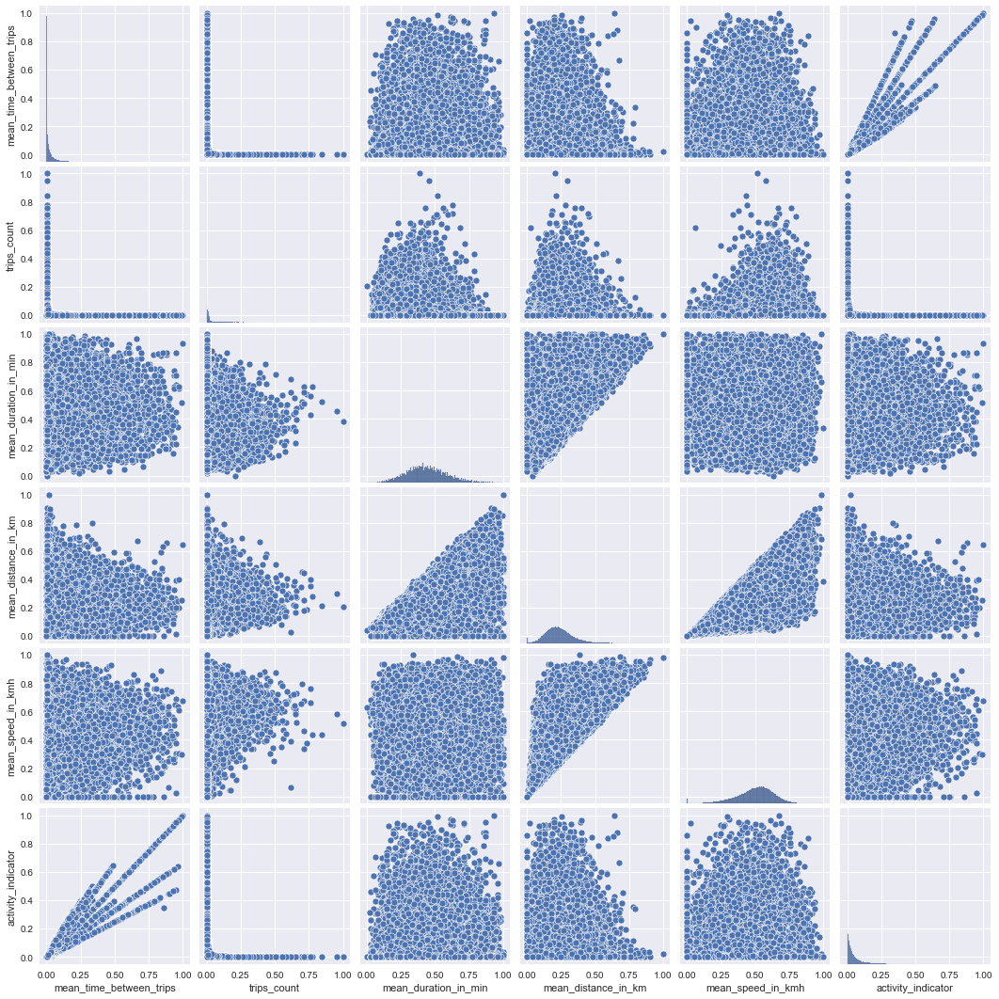

In [100]:
sns.pairplot(
    users_scaled[[
        "mean_time_between_trips",
        "trips_count",
        "mean_duration_in_min",
        "mean_distance_in_km",
        "mean_speed_in_kmh",
        "activity_indicator"
    ]]
)

<AxesSubplot:xlabel='mean_time_between_trips', ylabel='activity_indicator'>

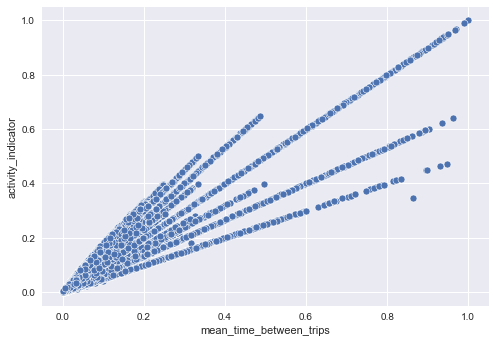

In [103]:
sns.scatterplot(data=users_scaled, x="mean_time_between_trips", y="activity_indicator")

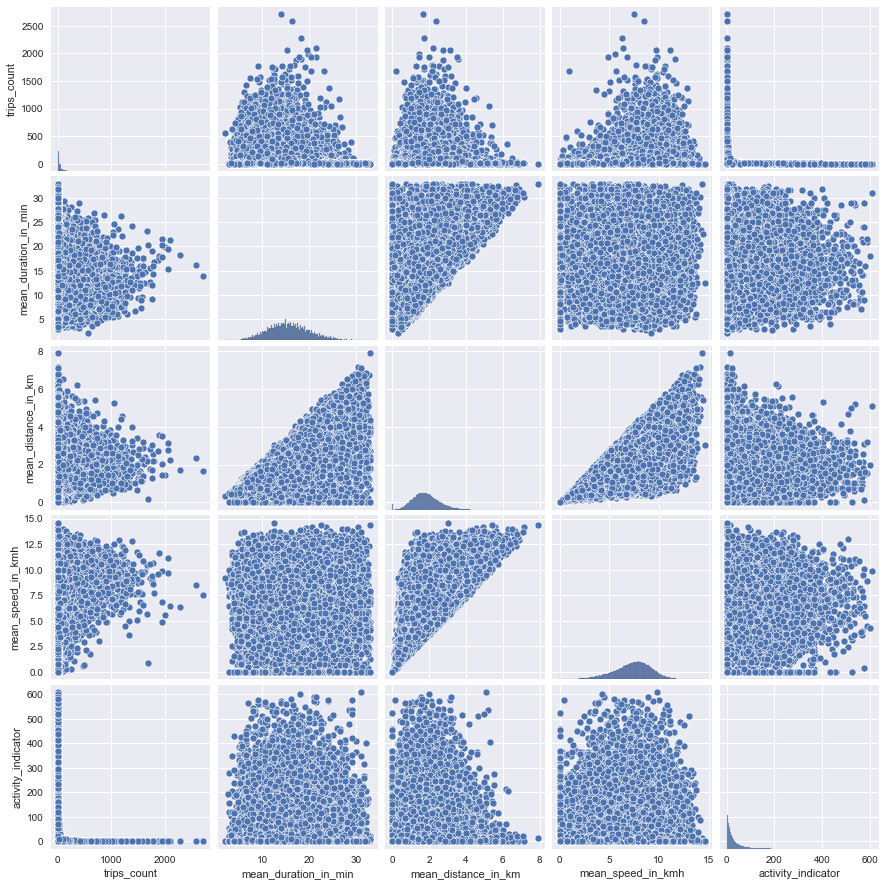

In [96]:
sns.pairplot(
    users[[
        "trips_count",
        "mean_duration_in_min",
        "mean_distance_in_km",
        "mean_speed_in_kmh",
        "activity_indicator"
    ]]
)

In [ ]:
from sklearn.cluster import KMeans

km = KMeans(n_clusters=3, 
            init='random', 
            n_init=10, 
            max_iter=300,
            tol=1e-04,
            random_state=0)

y_km = km.fit_predict(X)

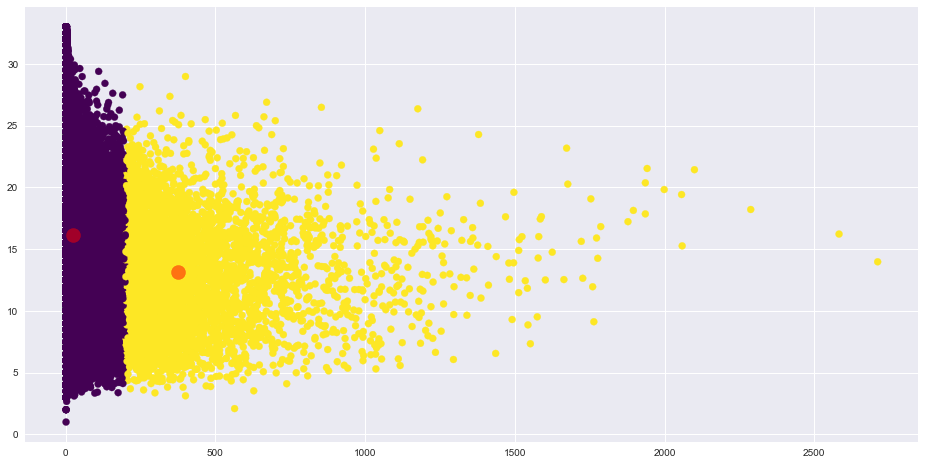

In [23]:
from sklearn.cluster import KMeans

features = (
    users.trips_count, 
    #users.active_period_in_days, 
    users.mean_duration_in_min, 
    users.mean_distance_in_km, 
    #users.mean_speed_in_kmh,
)
X = np.column_stack(features)
clusters = 2

kmeans = KMeans(clusters)
kmeans.fit(X)
y_kmeans = kmeans.fit_predict(X)
centers = kmeans.cluster_centers_

plt.figure(figsize=(16,8))
plt.scatter(X[:, 0], X[:, 1], c=y_kmeans, cmap="viridis")
plt.scatter(centers[:, 0], centers[:, 1], s=200, alpha=0.5, c="red");

In [ ]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

features = (
    users.trips_count, 
    #users.active_period_in_days, 
    users.mean_duration_in_min, 
    users.mean_distance_in_km, 
    #users.mean_speed_in_kmh,
)
clusters = 2

scaler = StandardScaler()
kmeans = KMeans(clusters)

pipeline = make_pipeline(scaler, kmeans)
pipeline.fit(test_data)

In [17]:
clustering_df = users[["trips_count", "mean_duration_in_min", "mean_distance_in_km", "type"]].copy()
clustering_df.type = clustering_df.type.map({"casual": 0, "regular": 1})

train_data, test_data = train_test_split(clustering_df)

In [18]:
test_data

,trips_count,mean_duration_in_min,mean_distance_in_km,type
user_id,,,,
C7E53FBCC2C360D29BEB467647F091021FB069CB,105,21.352381,3.032296,0
A896BE7ACDA17B4FED5318F377FCEF5CA5689DBF,12,14.833333,1.678181,0
0F6C3049DB59551279EA62F71F704C8BB0E4C971,107,12.271028,1.889460,0
275A381788C67EDC2AEE3CFB8DE25E362A93FFAA,7,11.285714,1.509555,0
1A79023A4FDDE43529457A7737F67E91CE4CC857,53,15.169811,1.845451,0
...,...,...,...,...
C79C18EC31170F8763D46DF55A58E1429663F7FA,9,18.111111,2.336453,0
9ABF6E0539BEC88DC7C8B6260582809A628DE5BC,3,10.333333,1.726209,0
0ABBB572A2A851B5408C1010F5D2EDB6810E5D5E,2,22.000000,2.496726,0


In [25]:
#from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
#from sklearn.pipeline import Pipeline

scaler = StandardScaler()
knn = KNeighborsClassifier(n_neighbors=15)

#data = users[["trips_count", "mean_duration_in_min", "mean_distance_in_km", "mean_speed_in_kmh"]]

#pipeline = Pipeline([("knn", knn)])
pipeline = make_pipeline(scaler, knn)
pipeline.fit(np.column_stack(test_data))

ValueError: This KNeighborsClassifier estimator requires y to be passed, but the target y is None.

In [ ]:
regular_users = users[users.type == "regular"]
casual_users = users[users.type == "casual"]

In [ ]:
regular_users.sample(5)

In [ ]:
casual_users.sample(5)

In [ ]:
users.describe()

In [ ]:
regular_users.describe()

In [ ]:
casual_users.describe()

In [ ]:
plt.figure(figsize=(16, 8))
sns.histplot(users, x="mean_duration_in_min", hue="type", element="bars", discrete=True, multiple="dodge")

<AxesSubplot:xlabel='mean_distance_in_km', ylabel='Count'>

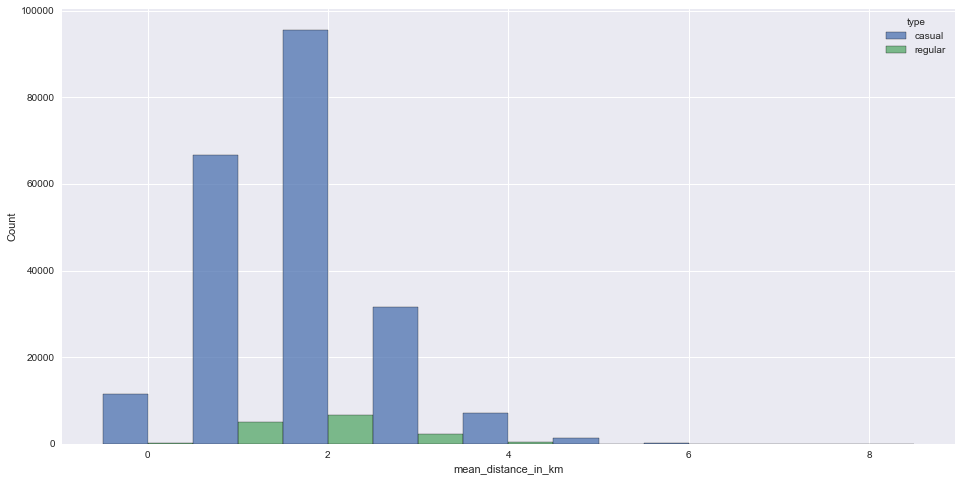

In [26]:
plt.figure(figsize=(16, 8))
sns.histplot(users, x="mean_distance_in_km", hue="type", element="bars", discrete=True, multiple="dodge")

In [ ]:
plt.figure(figsize=(16, 8))
sns.histplot(users, x="mean_speed_in_kmh", hue="type", element="bars", discrete=True, multiple="dodge")

In [ ]:
plt.figure(figsize=(16, 8))
sns.histplot(users, x="mean_speed_in_kmh", element="bars", discrete=True)

In [ ]:
trips = trips.merge(users[["type"]], left_on="user_id", right_index=True)
trips.sample(5)

In [ ]:
plt.figure(figsize=(16, 8))
ax = sns.histplot(trips, x="duration_in_min", hue="type", element="bars", discrete=True, multiple="dodge")
ax.set(xlabel="Trip duration in min", ylabel="Count")
plt.savefig("figures/trip_duration_by_users.png", bbox_inches="tight")
plt.show()

In [ ]:
plt.figure(figsize=(16, 8))
ax = sns.histplot(trips, x="distance_in_km", hue="type", element="bars", discrete=True, multiple="dodge")
ax.set(xlabel="Distance in km", ylabel="Count")
plt.savefig("figures/trip_distance_by_users.png", bbox_inches="tight")
plt.show()

In [ ]:
plt.figure(figsize=(16, 8))
ax = sns.histplot(trips, x="speed_in_kmh", hue="type", element="bars", discrete=True, multiple="dodge")
ax.set(xlabel="Speed in km/h", ylabel="Count")
plt.savefig("figures/trip_speed_by_users.png", bbox_inches="tight")
plt.show()

In [ ]:
trips[trips.type == "casual"].describe()

In [ ]:
trips[trips.type == "regular"].describe()

In [ ]:
plt.figure(figsize=(16, 8))
sns.relplot(data=regular_users, x="mean_duration_in_min", y="mean_distance_in_km", hue="type")

In [ ]:
plt.figure(figsize=(16, 8))
sns.relplot(data=casual_users, x="mean_duration_in_min", y="mean_distance_in_km", hue="type")

In [ ]:
plt.figure(figsize=(16, 8))
sns.pairplot(users[users.type == "casual"])

In [ ]:
plt.figure(figsize=(16, 8))
sns.pairplot(users[users.type == "regular"])

In [ ]:
# How many users are labelled as casual/regular?
plt.rcParams.update({'font.size': 20})

value_counts = users.groupby("type").size()
fig, ax = plt.subplots(figsize=(13,8))
ax.pie(value_counts, labels=value_counts.index, autopct="%1.1f%%", startangle=90)
ax.axis("equal")
plt.savefig("figures/trips_by_user_types.png", bbox_inches="tight")
plt.show()

In [ ]:
# How many trips are labelled as casual/regular?

value_counts = trips.groupby("type").size()
fig, ax = plt.subplots(figsize=(13,8))
ax.pie(value_counts, labels=value_counts.index, autopct="%1.1f%%", startangle=90)
ax.axis("equal")
plt.savefig("figures/users_by_types.png", bbox_inches="tight")
plt.show()

In [ ]:
tmp = trips.copy()
tmp.loc[trips.booked_via.str.startswith("Terminal"), "booked_via"] = "Terminal"
tmp.loc[trips.booked_via.str.startswith("terminal"), "booked_via"] = "Terminal"
tmp.loc[trips.booked_via.str.startswith("Techniker"), "booked_via"] = "Techniker"
tmp.loc[trips.booked_via.str.startswith("Starenkasten"), "booked_via"] = "Starenkasten"

rarely_used_booked_via = [
    'Android',
    'BlackBerry',
    'Windows',
    'iPhone KON',
    'CaB - Mobility Map',
    'LIDL-BIKE',
    'Android KON',
    'Starenkasten'
]

tmp["booked_via"] = tmp[["booked_via"]].replace(rarely_used_booked_via, "Other")

In [ ]:
plt.figure(figsize=(16,8))
ax = sns.countplot(
    data=tmp,
    y="booked_via",
    hue="type",
    order = tmp.booked_via.value_counts().index
)
ax.set(xlabel="Count", ylabel="Booked via")
plt.savefig("figures/booked_via.png", bbox_inches="tight")
plt.show()